In [ ]:
import os
import sys
import torch
need_pytorch3d=False
try:
    import pytorch3d
except ModuleNotFoundError:
    need_pytorch3d=True
if need_pytorch3d:
    if torch.__version__.startswith("1.12.") and sys.platform.startswith("linux"):
        # We try to install PyTorch3D via a released wheel.
        pyt_version_str=torch.__version__.split("+")[0].replace(".", "")
        version_str="".join([
            f"py3{sys.version_info.minor}_cu",
            torch.version.cuda.replace(".",""),
            f"_pyt{pyt_version_str}"
        ])
        !pip install fvcore iopath
        !pip install --no-index --no-cache-dir pytorch3d -f https://dl.fbaipublicfiles.com/pytorch3d/packaging/wheels/{version_str}/download.html
    else:
        # We try to install PyTorch3D from source.
        !curl -LO https://github.com/NVIDIA/cub/archive/1.10.0.tar.gz
        !tar xzf 1.10.0.tar.gz
        os.environ["CUB_HOME"] = os.getcwd() + "/cub-1.10.0"
        !pip install 'git+https://github.com/facebookresearch/pytorch3d.git@stable'

In [45]:
import numpy as np
import torch
import torch.nn.functional as F
import matplotlib.pyplot as plt

from pytorch3d.structures import Pointclouds
from pytorch3d.vis.plotly_vis import AxisArgs, plot_batch_individually, plot_scene
from pytorch3d.renderer import (
    look_at_view_transform,
    FoVOrthographicCameras,
    PointsRasterizationSettings,
    PointsRenderer,
    PulsarPointsRenderer,
    PointsRasterizer,
    AlphaCompositor,
    NormWeightedCompositor
)


In [21]:
!mkdir -p data/PittsburghBridge
!wget -P data/PittsburghBridge https://dl.fbaipublicfiles.com/pytorch3d/data/PittsburghBridge/pointcloud.npz

--2022-09-30 11:22:56--  https://dl.fbaipublicfiles.com/pytorch3d/data/PittsburghBridge/pointcloud.npz
Resolving dl.fbaipublicfiles.com (dl.fbaipublicfiles.com)... 172.67.9.4, 104.22.75.142, 104.22.74.142
Connecting to dl.fbaipublicfiles.com (dl.fbaipublicfiles.com)|172.67.9.4|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 5701352 (5.4M) [application/zip]
Saving to: 'data/PittsburghBridge/pointcloud.npz.1'

pointcloud.npz.1    100%[===================>]   5.44M  5.16MB/s    in 1.1s    

2022-09-30 11:22:58 (5.16 MB/s) - 'data/PittsburghBridge/pointcloud.npz.1' saved [5701352/5701352]



In [28]:
## setup device
if torch.cuda.is_available():
    device = torch.device("cuda:0")
    torch.cuda.set_device(device)
else:
    device = torch.device("cpu")

## set path
DATA_PATH = './data'
obj_filename = os.path.join(DATA_PATH, 'PittsburghBridge/pointcloud.npz')

## load point cloud
pointcloud = np.load(obj_filename)
verts = torch.Tensor(pointcloud['verts']).to(device)
rgb = torch.Tensor(pointcloud['rgb']).to(device)
point_cloud = Pointclouds(points = [verts], features = [rgb])

In [32]:
R, T = look_at_view_transform(20, 10, 0)
cameras = FoVOrthographicCameras(device = device, R = R, T = T, znear = 0.01)

raster_settings = PointsRasterizationSettings(
    image_size = 512,
    radius = 0.003,
    points_per_pixel = 10
)

rasterizer = PointsRasterizer(
    cameras = cameras,
    raster_settings = raster_settings
)
renderer = PointsRenderer(
    rasterizer = rasterizer,
    compositor = AlphaCompositor()
)

(-0.5, 511.5, 511.5, -0.5)

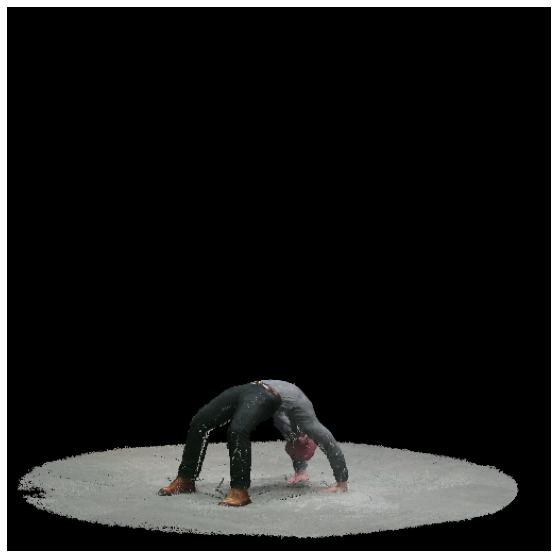

tensor([[[[0., 0., 0., 0.],
          [0., 0., 0., 0.],
          [0., 0., 0., 0.],
          ...,
          [0., 0., 0., 0.],
          [0., 0., 0., 0.],
          [0., 0., 0., 0.]],

         [[0., 0., 0., 0.],
          [0., 0., 0., 0.],
          [0., 0., 0., 0.],
          ...,
          [0., 0., 0., 0.],
          [0., 0., 0., 0.],
          [0., 0., 0., 0.]],

         [[0., 0., 0., 0.],
          [0., 0., 0., 0.],
          [0., 0., 0., 0.],
          ...,
          [0., 0., 0., 0.],
          [0., 0., 0., 0.],
          [0., 0., 0., 0.]],

         ...,

         [[0., 0., 0., 0.],
          [0., 0., 0., 0.],
          [0., 0., 0., 0.],
          ...,
          [0., 0., 0., 0.],
          [0., 0., 0., 0.],
          [0., 0., 0., 0.]],

         [[0., 0., 0., 0.],
          [0., 0., 0., 0.],
          [0., 0., 0., 0.],
          ...,
          [0., 0., 0., 0.],
          [0., 0., 0., 0.],
          [0., 0., 0., 0.]],

         [[0., 0., 0., 0.],
          [0., 0., 0., 0.],
    

(-0.5, 511.5, 511.5, -0.5)

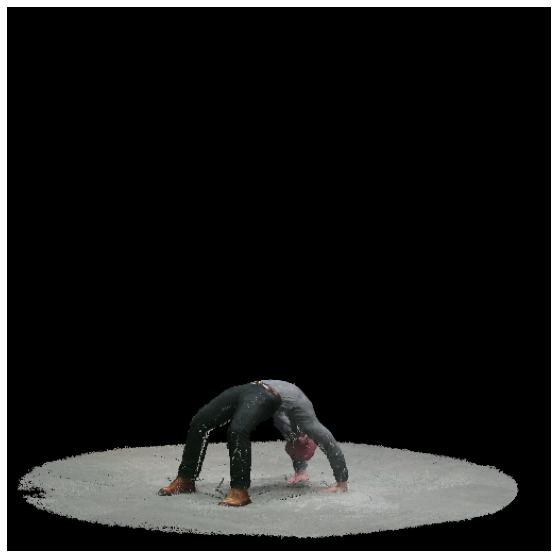

In [31]:
images = renderer(point_cloud)

plt.figure(figsize=(10, 10))
plt.imshow(images[0, ..., :3].cpu().numpy())
plt.axis("off")

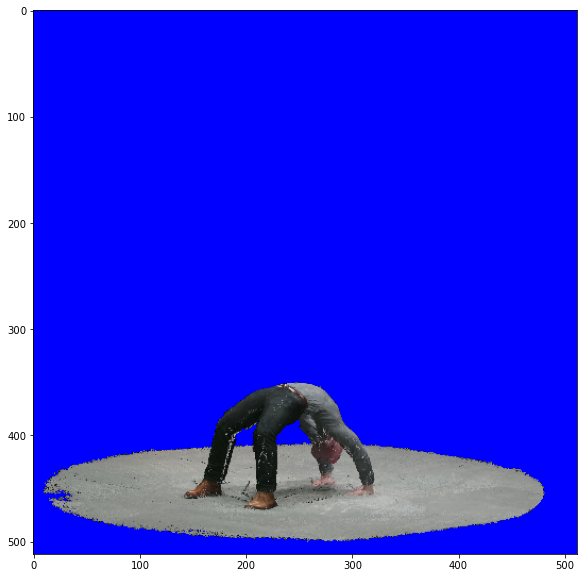

In [33]:
renderer = PointsRenderer(
    rasterizer = rasterizer,
    compositor = AlphaCompositor(
        background_color = (0, 0, 1)
    )
)
images = renderer(point_cloud)

plt.figure(figsize = (10, 10))
plt.imshow(images[0, ..., :3].cpu().numpy())
plt.show('off')

In [39]:
R, T = look_at_view_transform(20, 10, 0)
cameras = FoVOrthographicCameras(
    device = device,
    R = R,
    T = T,
    znear = 0.01
)

raster_settings = PointsRasterizationSettings(
    image_size = 512,
    radius = 0.003,
    points_per_pixel = 10
)

renderer = PointsRenderer(
    rasterizer = PointsRasterizer(
        cameras = cameras,
        raster_settings = raster_settings
    ),
    compositor = NormWeightedCompositor()
)

(-0.5, 511.5, 511.5, -0.5)

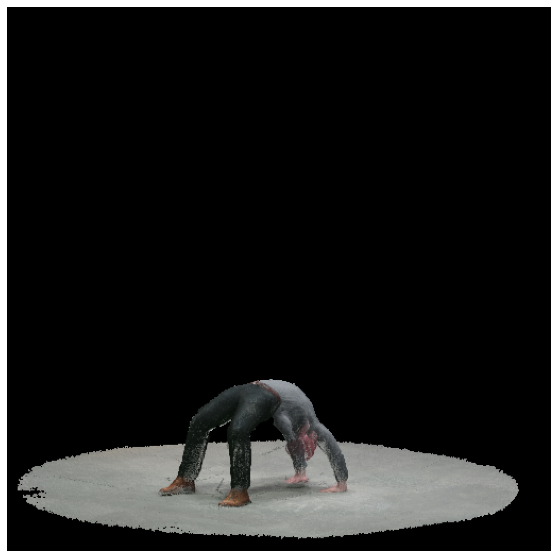

(-0.5, 511.5, 511.5, -0.5)

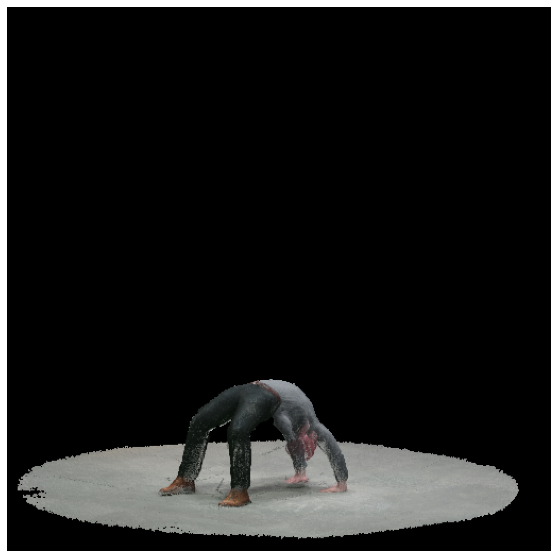

In [40]:
images = renderer(point_cloud)
plt.figure(figsize=(10, 10))
plt.imshow(images[0, ..., :3].cpu().numpy())
plt.axis("off")

(-0.5, 511.5, 511.5, -0.5)

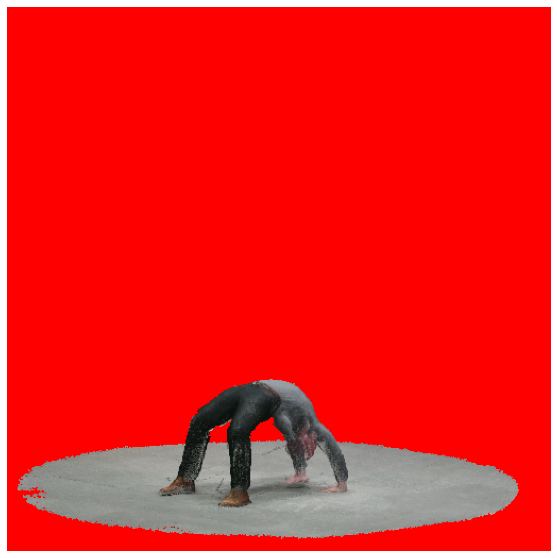

(-0.5, 511.5, 511.5, -0.5)

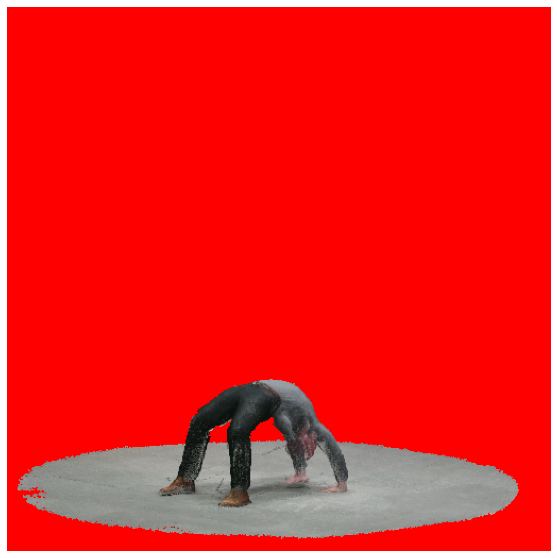

In [41]:
renderer = PointsRenderer(
    rasterizer = PointsRasterizer(
        cameras = cameras,
        raster_settings = raster_settings
    ),
    compositor = NormWeightedCompositor(
        background_color = (1, 0, 0) ## 배경화면 색상 수정
    )
)
images = renderer(point_cloud)
plt.figure(figsize = (10, 10))
plt.imshow(images[0, ..., :3].cpu().numpy())
plt.axis('off')

AttributeError: module 'matplotlib.pyplot' has no attribute 'axos'

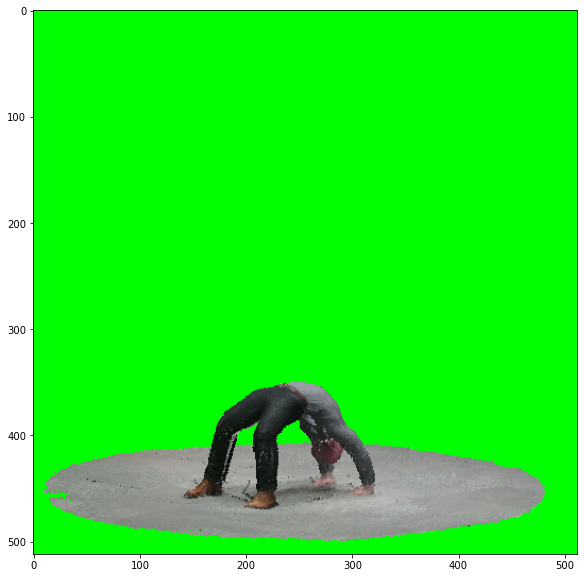

In [42]:
## using the pulsar backend

renderer = PulsarPointsRenderer(
    rasterizer = PointsRasterizer(
        cameras = cameras,
        raster_settings = raster_settings
    ),
    n_channels = 4
).to(device)

images = renderer(
    point_cloud,
    gamma = (1e-4,),
    bg_col = torch.tensor([ 0.0, 1.0, 0.0, 1.0 ], dtype = torch.float32, device = device)
)
plt.figure(figsize = (10, 10))
plt.imshow(images[0, ..., :3].cpu().numpy())
plt.axis('off')

In [43]:
## View Point clouds in plotly figures
plot_scene({
    "Pointcloud": {
        "person": point_cloud
    }
})

point_cloud_batch = Pointclouds(
    points = [verts, verts + 2],
    features = [ rgb, torch.zeros_like(rgb) ]
)

fig = plot_scene({
    "Pointcloud": {
        "person1": point_cloud_batch[0],
        "person2": point_cloud_batch[1]
    }
})
fig.show()

In [44]:
fig = plot_scene({
    "Pointcloud": {
        "2 people": point_cloud_batch
    }
})
fig.show()

In [ ]:
fig2 = plot_batch_individually(point_cloud_batch, ncols = 2)
fig2.show()

In [49]:
fig2.update_layout(
    height = 500,
    width = 500
)
fig2.show()

In [ ]:
fig3 = plot